# Assignment 5 - Collaborative Filtering Recommender for Books
---
Nicholas Belev

Professor Santiago Gil Begue

Chatbots and Recommendation Engines

6 March 2025

---

## Familiarization with the Books Dataset

In [1]:
!pip install -q matplotlib==3.7.3

Restart after the older version of Matplotlib is installed for recmetrics to go into effect

In [2]:
!pip install scikit-surprise

In [3]:
!pip install recmetrics

In [4]:
# Math and data handling
import pandas as pd
import numpy as np

# Visualizations
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

import recmetrics
from tqdm import tqdm

# CF models and ML training, testing, evaluating
from surprise import Reader, Dataset, SVD, SVDpp, NMF, KNNBasic, accuracy, Prediction
from surprise.model_selection import train_test_split, cross_validate, KFold

my_seed = 20040824

Download **Book Recommendations** dataset from Kaggle

In [5]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("arashnic/book-recommendation-dataset")
print("Path to dataset files:", path)

100%|██████████| 24.3M/24.3M [00:00<00:00, 59.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/arashnic/book-recommendation-dataset/versions/3


In [6]:
!ls /root/.cache/kagglehub/datasets/arashnic/book-recommendation-dataset/versions/3

Books.csv  classicRec.png  DeepRec.png	Ratings.csv  recsys_taxonomy2.png  Users.csv


In [7]:
# Above we can see all the files / data of interest

path_str = "/root/.cache/kagglehub/datasets/arashnic/book-recommendation-dataset/versions/3"

# These are those files
books_df = pd.read_csv(path_str + "/Books.csv")
ratings_df = pd.read_csv(path_str + "/Ratings.csv")
users_df = pd.read_csv(path_str + "/Users.csv")

<ipython-input-7-21fa9bad3bc2>:6: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  books_df = pd.read_csv(path_str + "/Books.csv")


In [8]:
books_df.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


Above are the details of each book, which are represented as an ISBN for space efficiency in the Ratings dataframe below.  This association is effective to merge the datasets together for readibility of title instead of just a code

In [9]:
users_df.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


Similarly, above are the user details, who are simplified to just an ID for the ratings dataframe

**Ratings:** Contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0 (no interaction / rating provided by the user).

In [10]:
ratings_df.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


Above is the ratings dataframe which has inputs (user, book) and output (rating on a scale of 1-10, or 0 if omitted).  This is enough information to determine user-user similarity and create a collaborative filtering recommender; the goal of this assignment.

In [11]:
print(f"There are {ratings_df['User-ID'].nunique()} individual users.")
print(f"There are {ratings_df['ISBN'].nunique()} total books.")
print(f"There are {ratings_df.shape[0]} total ratings accounted for in this dataset.")

There are 105283 individual users.
There are 340556 total books.
There are 1149780 total ratings accounted for in this dataset.


General information found in the dataset

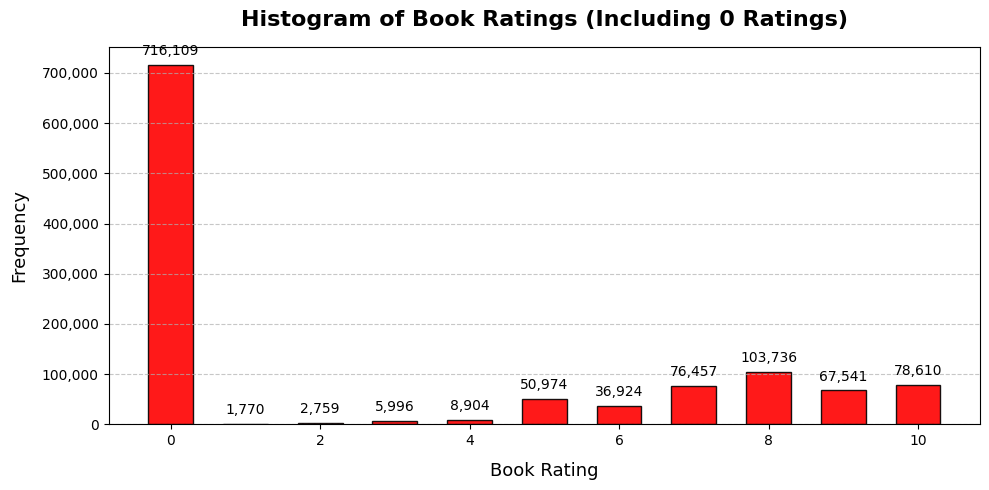

In [12]:
# Sort by book ratings to count each type of rating once grouped
rating_counts = ratings_df['Book-Rating'].value_counts().sort_index()

# Histogram of the ratings -- a distribution
fig, ax = plt.subplots(figsize=(10, 5))
bars = ax.bar(rating_counts.index, rating_counts.values, color='red', edgecolor='black', width=0.6, alpha=0.9)

ax.set_title('Histogram of Book Ratings (Including 0 Ratings)', fontsize=16, fontweight='bold', pad=15)
ax.set_xlabel('Book Rating', fontsize=13, labelpad=10)
ax.set_ylabel('Frequency', fontsize=13, labelpad=10) # Labeling

# Customize axes
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x):,}'))
ax.grid(axis='y', linestyle='--', alpha=0.7)

# Add numerics to bars
for bar in bars:
    height = bar.get_height()
    ax.annotate(f'{int(height):,}',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 5),
                textcoords='offset points',
                ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()


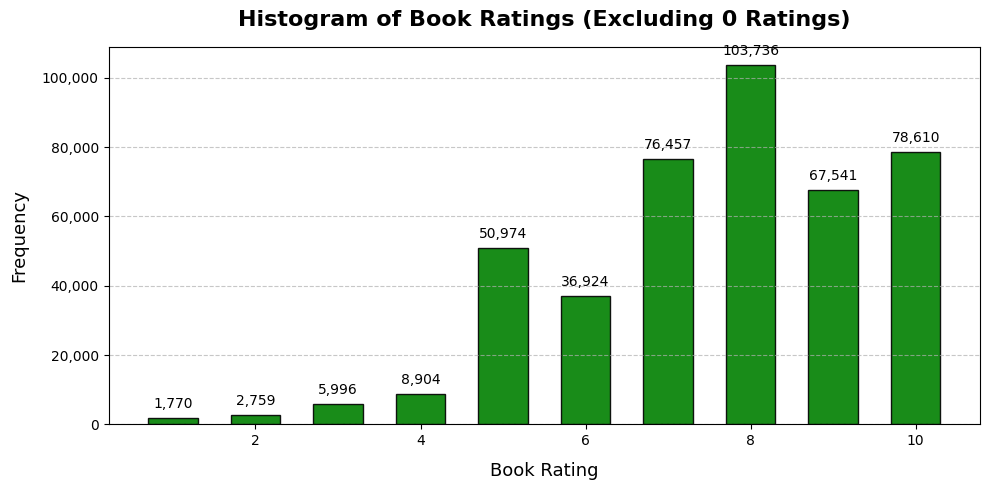

In [13]:
# Exclude ratings of 0
ratings_nonzero_df = ratings_df[ratings_df['Book-Rating'] != 0]

# Same histogram essentially
rating_counts = ratings_nonzero_df['Book-Rating'].value_counts().sort_index()

fig, ax = plt.subplots(figsize=(10, 5))

bars = ax.bar(rating_counts.index, rating_counts.values, color='green', edgecolor='black', width=0.6, alpha=0.9)

ax.set_title('Histogram of Book Ratings (Excluding 0 Ratings)', fontsize=16, fontweight='bold', pad=15)
ax.set_xlabel('Book Rating', fontsize=13, labelpad=10)
ax.set_ylabel('Frequency', fontsize=13, labelpad=10)

ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, _: f'{int(x):,}'))
ax.grid(axis='y', linestyle='--', alpha=0.7)

for bar in bars:
    height = bar.get_height()
    ax.annotate(f'{int(height):,}',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 5),
                textcoords='offset points',
                ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

Note that the long trail phenomenon applies to this dataset, revealing that there are a select few set of books with numerous reviews, while there are a majority that have very few, often less than 2, or even no reviews (0).

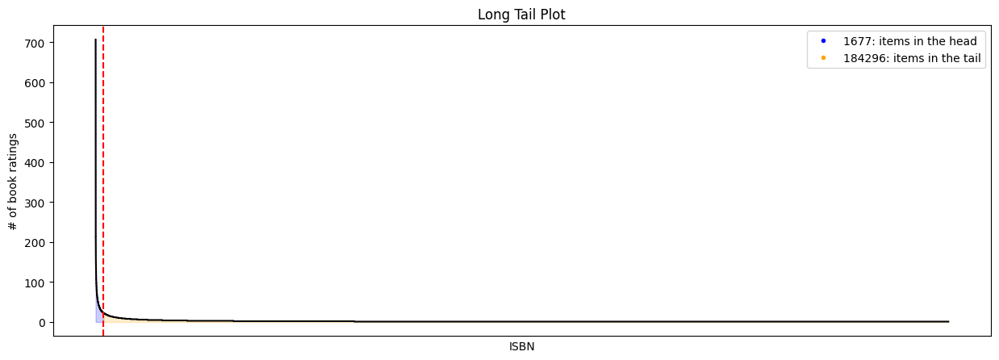

In [14]:
mean1 = ratings_nonzero_df['Book-Rating'].mean()
std1 = ratings_nonzero_df['Book-Rating'].std()
print(f'The distribution of explicit ratings has a mean of {round(mean1, 2)} and standard deviation of {round(std1, 4)}')


mean2 = ratings_df['Book-Rating'].mean()
std2 = ratings_df['Book-Rating'].std()
print(f'The distribution of total ratings (including zeroes) has a mean of {round(mean2, 2)} and standard deviation of {round(std2, 4)}')

The distribution of explicit ratings has a mean of 7.6 and standard deviation of 1.8438
The distribution of total ratings (including zeroes) has a mean of 2.87 and standard deviation of 3.8542


There is a clear discrepancy and positive skew caused by including the plethora of zero ratings (implicitly uninteracted books).

Note given that there is a large quantity of (user, item) pairs that have not been given an explicit recommendation, we will focus our training and testing dataset on the fully-explicitly-rated dataset, `ratings_nonzero_df`

In [15]:
ratings_CF_df = ratings_nonzero_df[['User-ID', 'ISBN', 'Book-Rating']]

predictions_mean = [Prediction(uid, iid, r_ui, mean1, {}) for uid, iid, r_ui in
                    ratings_CF_df.itertuples(index=False, name=None)]
accuracy.rmse(predictions_mean);
accuracy.mae(predictions_mean);

RMSE: 1.8438
MAE:  1.4963


Note that the Root Mean Squared Error is equivalent to the standard deviation of the dataset, because when we replace the set of predictions with repeatedly providing the mean, we are measuring how far off each datapoint is from the mean (squared) which is the definition of variance, which when we take the Root, is just the standard deviation of the user-book ratings.

## Model-Based Collaborative Filtering

In [16]:
# Format our dataset to Surprise's requirements
reader = Reader(rating_scale=(1, 10)) # 1-10 "star" ratings for each book
data = Dataset.load_from_df(ratings_CF_df[['User-ID', 'ISBN', 'Book-Rating']], reader)

Note that the SVD algorithm is a matrix factorization method, that implements Singular Value Decomposition.  As such, it is a model-based algorithm.  To simplify, it works by factoring our sparse User-Item dimensions matrix (with ratings as its entries) into factor matrices, for example, with dimensions U x L and L x I, where U ~ number of Users; I ~ number of Items (Books); L ~ the number of latent factors (a hyperparameter to be explored further).

In [17]:
algo_model_based = SVD(random_state=my_seed)

# Standard 80 / 20 train test split
trainset_model_based, testset_model_based = train_test_split(data, test_size=.20, random_state=my_seed)

Seeding the random library so that re-running stochastic functions yields the same "random" outcome.  This will work for all future uses of random-based functions

In [18]:
import random

random.seed(my_seed)
np.random.seed(my_seed) # Replicatability

In [19]:
algo_model_based.fit(trainset_model_based); # Fit based on the training portion of the data

In [20]:
predictions_mb = algo_model_based.test(testset_model_based)

In [21]:
accuracy.rmse(predictions_mb);
accuracy.mae(predictions_mb);

RMSE: 1.6368
MAE:  1.2650


Note that both RMSE and MAE (statistical measures of accuracy) have decreased by roughly 0.2 from when we sampled randomly based on the discrete distribution.  This indicates that using a collaborative filtering mechanism has indeed improved prediction accuracy for the test dataset.

In [22]:
performance_mb = cross_validate(algo_model_based, data, measures=['RMSE', 'MAE'],
                             cv=KFold(n_splits=5, random_state=my_seed),
                             return_train_measures=True, verbose=True, n_jobs=-1)

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.6441  1.6372  1.6467  1.6411  1.6368  1.6412  0.0039  
MAE (testset)     1.2681  1.2629  1.2688  1.2693  1.2650  1.2668  0.0025  
RMSE (trainset)   1.0044  1.0052  1.0041  1.0037  1.0046  1.0044  0.0005  
MAE (trainset)    0.7679  0.7678  0.7675  0.7664  0.7679  0.7675  0.0006  
Fit time          13.31   12.25   12.27   11.51   7.11    11.29   2.17    
Test time         0.77    0.85    0.77    0.92    0.61    0.78    0.10    


In general, the reduction to both Root Mean Squared Error, and Mean Absolute Error (which is less sensitive to outliers) is more significant in the larger training set, although in all random folds, the reduction from the original values is significant indicating an effective model.

In [23]:
print("Average Test RMSE:", np.mean(performance_mb['test_rmse']))
print("Average Train RMSE:", np.mean(performance_mb['train_rmse']))
print("--")
print("Average Test MAE:", np.mean(performance_mb['test_mae']))
print("Average Train MAE:", np.mean(performance_mb['train_mae']))

Average Test RMSE: 1.641199843115896
Average Train RMSE: 1.0043798424478942
--
Average Test MAE: 1.2668445376498387
Average Train MAE: 0.7674849277188125


The average across all folds, along with the standard deviations above confirms the consistency of these results.

Let us now test the prediction effectiveness of our algorithm.

In [24]:
print(len(testset_model_based))
print(len(predictions_mb))
print(len(testset_model_based) == len(predictions_mb)) # The test set is what we're predicting off of, they are synonymous

86735
86735
True


In [25]:
predictions_mb[0:10] # First 10 predictions

[Prediction(uid=258185, iid='0515129933', r_ui=7.0, est=7.770450426320837, details={'was_impossible': False}),
 Prediction(uid=110265, iid='0821737171', r_ui=5.0, est=7.872189348679351, details={'was_impossible': False}),
 Prediction(uid=98391, iid='0312307535', r_ui=5.0, est=9.15516154784044, details={'was_impossible': False}),
 Prediction(uid=1903, iid='0316441791', r_ui=10.0, est=8.252503855145283, details={'was_impossible': False}),
 Prediction(uid=11676, iid='006000942X', r_ui=3.0, est=6.350401632585906, details={'was_impossible': False}),
 Prediction(uid=115435, iid='0375702709', r_ui=10.0, est=8.393865085781899, details={'was_impossible': False}),
 Prediction(uid=237411, iid='0671015575', r_ui=8.0, est=7.688408085877623, details={'was_impossible': False}),
 Prediction(uid=194809, iid='8881832437', r_ui=6.0, est=7.219858740410546, details={'was_impossible': False}),
 Prediction(uid=52509, iid='0671020943', r_ui=3.0, est=7.089105171667332, details={'was_impossible': False}),
 Pred

We can see that `est`, the estimate attempts to come as close to `r_ui`, the true rating as possible, however in a number of instances proves to not be perfect, underestimating "10 out of 10"'s and over-estimating "3 out of 10"'s.

In [26]:
uid = 1903
iid = '0316441791'

pred = algo_model_based.predict(uid, iid, r_ui=5, verbose=True) # A lookup function with behavior (User, Item) -> Rating_predicted`

user: 1903       item: 0316441791 r_ui = 5.00   est = 8.25   {'was_impossible': False}


In [27]:
num_ratings_by_user_df = ratings_CF_df.groupby('User-ID').size()
num_ratings_by_user_df[num_ratings_by_user_df >= 20].sort_values().head(10)
# A dataframe of users that have given 20 or more ratings, effectively mitigates the "cold start" problem
# (to have the right length where order significantly impacts the discounted gain)

,0
User-ID,
278843,20
18850,20
154441,20
154354,20
37447,20
151824,20
150067,20
144516,20
144194,20


In [28]:
uid = 151824 # We'll zero in on this particular user to create a recommendation for them
given_user_df = ratings_CF_df[ratings_CF_df['User-ID'] == uid].sort_values(by='Book-Rating', ascending=False)
given_user_df.head()

,User-ID,ISBN,Book-Rating
626375,151824,0061058092,10
626399,151824,0440224721,10
626378,151824,0312203594,10
626379,151824,0312874006,10
626386,151824,0399146512,10


In [29]:
given_user_df.merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]
# A more reader-friendly comprehensive ratings breakdown for user 151824

,Book-Title,Book-Rating
0,Child of Venus,10
1,Obstruction of Justice,10
2,Alice's Tulips,10
3,Angel of Darkness (Key Books),10
4,"Three Complete Novels: Mind Prey, Sudden Prey,...",10
5,Year of Wonders: A Novel of the Plague,10
6,A Stitch in Time (Needlecraft Mysteries),10
7,The Red Tent (Bestselling Backlist),10
8,Stone Kiss (Peter Decker &amp; Rina Lazarus No...,10
9,Barrel Fever : Stories and Essays (Barrel Fever),9


In [30]:
already_rated = given_user_df['ISBN'].unique()
all_items = ratings_CF_df['ISBN'].unique()
items_to_rate = [x for x in all_items if x not in already_rated]

In [31]:
all_predictions = {}
for iid in items_to_rate:
  est = algo_model_based.predict(uid, iid).est
  all_predictions[iid] = est

In [32]:
len(all_predictions)

185953

These are all the books including the ones that user 1903 has not rated, complete with estimated ratings for this user, from which we can finally produce a set of top recommended items for them, based on highest predicted score for the given user.

In [33]:
top_11_items = sorted(all_predictions.items(), reverse=True, key=lambda x:x[1])[:12]
pd.DataFrame(top_11_items, columns=['ISBN', 'Book-Rating']).merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,A Prayer for Owen Meany,9.744073
1,"The Two Towers (The Lord of the Rings, Part 2)",9.721803
2,Harry Potter and the Goblet of Fire (Book 4),9.685345
3,Dilbert: A Book of Postcards,9.678749
4,Harry Potter and the Chamber of Secrets Postca...,9.647472
5,Calvin and Hobbes,9.631667
6,"My Sister's Keeper : A Novel (Picoult, Jodi)",9.545054
7,The Authoritative Calvin and Hobbes (Calvin an...,9.484999
8,Harry Potter and the Prisoner of Azkaban (Book 3),9.476599
9,Lonesome Dove,9.433325


It seems this user is a fan of fantasy genres considering that 4 separate Harry Potter books appear in this person's list of top 11 recommended books (as per our model based CF engine).  Moreover, their second pick is a Lord of the Rings book.  Overall the consistency and coherency between books that seem similar by genre / content, developed by Colaborative Filtering signals that this may indeed be an effective recommendation set for this user.

In [34]:
bottom_11_items = sorted(all_predictions.items(), reverse=False, key=lambda x:x[1])[:11]
pd.DataFrame(bottom_11_items, columns=['ISBN', 'Book-Rating']).merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,Wild Animus,5.040123
1,Black Coffee Blues,5.648230
2,Isle of Dogs,5.745287
3,Four Blondes,5.982934
4,Isle of Dogs,6.068204
5,Confessions of a Sociopathic Social Climber : ...,6.219669
6,Inappropriate Men (Red Dress Ink),6.321561
7,Killing Time,6.346281
8,Sex and the City,6.356981
9,Soloalbum.,6.358461


Conversely, books that seem to be more "gossipy", dramatic, or related to psychologically ambiguous characters seem to interest this user the least.  Again, there is similarity amongst the book titles and genres in this list, which lends it credibility.

Next, we want to develop a complete pairing between predictions and true ratings for the full books dataset: this is effectively the database from which the model can be fully assessed as to its distribution of predictions per actual score per user--which will allow for a violin plot visual.

In [35]:
pred_df = pd.DataFrame([(x.r_ui, x.est) for x in predictions_mb],
                       columns=['true_rating', 'predicted_rating'])
pred_df.head(10)

,true_rating,predicted_rating
0,7.0,7.770450
1,5.0,7.872189
2,5.0,9.155162
3,10.0,8.252504
4,3.0,6.350402
5,10.0,8.393865
6,8.0,7.688408
7,6.0,7.219859
8,3.0,7.089105
9,10.0,7.395399


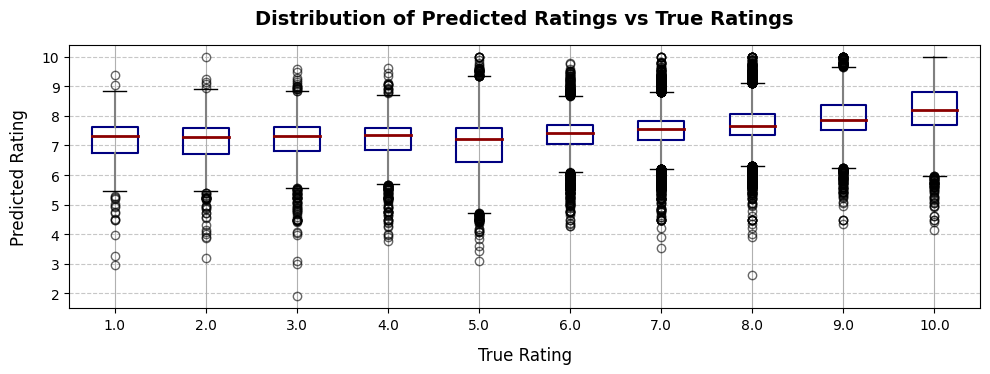

In [36]:
fig, ax = plt.subplots(figsize=(10, 4))

# Enhanced boxplot style
bp = pred_df.boxplot(
    by="true_rating", ax=ax,
    boxprops=dict(linewidth=1.5, color='navy'),
    medianprops=dict(linewidth=2, color='darkred'),
    whiskerprops=dict(linewidth=1.5, color='gray'),
    flierprops=dict(marker='o', color='purple', alpha=0.6)
)

# Better aesthetics with labels
plt.title("Distribution of Predicted Ratings vs True Ratings", fontsize=14, fontweight='bold', pad=15)
plt.suptitle('')  # Remove the automatic subtitle provided by pandas boxplot
ax.set_xlabel("True Rating", fontsize=12, labelpad=10)
ax.set_ylabel("Predicted Rating", fontsize=12, labelpad=10)
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


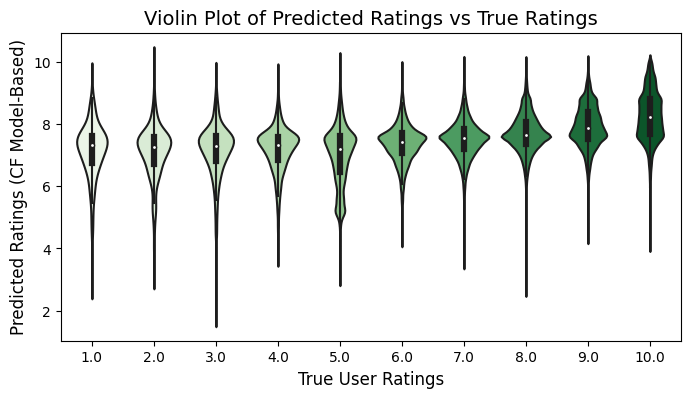

In [37]:
fig, ax = plt.subplots(figsize=(8, 4))
sns.violinplot(
    data=pred_df,
    x="true_rating",
    y="predicted_rating",
    palette="Greens"
)

ax.set_xlabel("True User Ratings", fontsize=12)
ax.set_ylabel("Predicted Ratings (CF Model-Based)", fontsize=12)
ax.set_title("Violin Plot of Predicted Ratings vs True Ratings", fontsize=14)

plt.show()

Both the Box Plot and the Violin Plot are equivalent ways to visualize how the predictions indeed have some positive accordance with the true user ratings.  Although the distributions are quite wide towards the lower (true 1.0 / 10.0) ratings and narrow with a positive skew as we approach high ratings (true 10.0 / 10.0).  The advantage of the box plot comes from discretely identifying outliers in the distributions at each true rating value (on the x-axis).  In summary these findings reveal that this Collaborative Filtering algorithm was relatively successful.

## BONUS: In-Depth Interpretation of Latent Factors

In [38]:
algo = NMF(n_factors=2)
algo.fit(trainset_model_based)
print(algo.pu.shape)
print(algo.qi.shape)

# If we were to train on the number of latent factors forced at 2, we wound end up with these two factor matrices:

(68507, 2)
(159071, 2)


In [39]:
algo = NMF(n_factors=15)
algo.fit(trainset_model_based)
print(algo.pu.shape)
print(algo.qi.shape)

# Same idea for 15 factors

(68507, 15)
(159071, 15)


In [40]:
algo = NMF(n_factors=50)
algo.fit(trainset_model_based)
print(algo.pu.shape)
print(algo.qi.shape)

# Same but a much longer fit time with 50 latent factors

(68507, 50)
(159071, 50)


In [41]:
len(algo.qi[0]) # (A x L) the length of the first row (or any row of A) is the number of columns, aka latent factors, L

50

In [42]:
len(algo.pu[0]) # (L x B) the length of the first column (or any column of B) is the number of rows, aka latent factors, L

50

In [43]:
np.dot(algo.qi[0], algo.pu[0]) # Effectively a prediction of the aligment between a user and an item

8.302745794812356

In [44]:
algo.estimate(0, 0) # Hence why this yields the same value

8.302745794812356

Next we can do an in-depth analysis of the correlation between accuracy (proxied by root mean squared error) and the number of latent factors that we fit a CF model with.

In [45]:
rmse_test_dict = {} # Dictionary of results of mean performance for number of latent factors

# 22 minutes of run time as of last
# tqdm to track the progress of our loop iterations
for n in tqdm(range(1, 60, 2)): # Up to 60 latent factors, increment by 2
  # Let's reduce n_epochs to speed up the execution
  algo = NMF(n_factors=n, n_epochs=10, random_state=my_seed)
  performance = cross_validate(algo, data, measures=['RMSE'],
                               cv=KFold(n_splits=4, random_state=my_seed),
                               verbose=False, n_jobs=-1)
  rmse_test_dict[n] = np.mean(performance['test_rmse'])

100%|██████████| 30/30 [19:29<00:00, 39.00s/it]


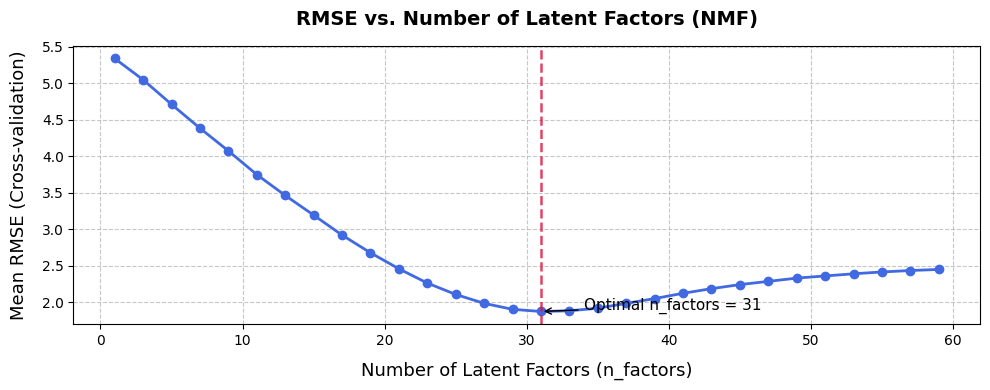

In [46]:
fig, ax = plt.subplots(figsize=(10, 4))

# Plot with enhanced visuals
ax.plot(list(rmse_test_dict.keys()), list(rmse_test_dict.values()),
        marker='o', linestyle='-', linewidth=2, markersize=6, color='royalblue')

# Highlight the best-performing number of latent factors
optimal_n = min(rmse_test_dict, key=rmse_test_dict.get)
ax.axvline(x=optimal_n, color='crimson', linestyle='--', linewidth=1.8, alpha=0.8)
ax.annotate(f'Optimal n_factors = {optimal_n}', xy=(optimal_n, rmse_test_dict[optimal_n]),
            xytext=(optimal_n+3, rmse_test_dict[optimal_n]+0.02),
            arrowprops=dict(facecolor='black', arrowstyle='->'),
            fontsize=11)

# Titles and labels
ax.set_title('RMSE vs. Number of Latent Factors (NMF)', fontsize=14, fontweight='bold', pad=15)
ax.set_xlabel('Number of Latent Factors (n_factors)', fontsize=13, labelpad=10)
ax.set_ylabel('Mean RMSE (Cross-validation)', fontsize=13, labelpad=10)

# Grid lines
ax.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


This visual reveals that we get a significant reduction in RMSE as we try more factors, though this effect minimizes at exactly 31 factors and then signs of overfitting emerge shortly after, as the RMSE begins to rise (though the rise appears to flatten too).

In [47]:
all_df = ratings_df.merge(books_df, on='ISBN')
data_title = Dataset.load_from_df(all_df[['User-ID', 'Book-Title', 'Book-Rating']], reader)

In [48]:
algo = SVDpp(n_factors=2, random_state=my_seed)
algo.fit(data_title.build_full_trainset());
# Another demonstratory CF model where we restrict latent factors to 2, allowing us to plot a 2D scatterplot of all books in the dataset

# Runs for 20 minutes

Note SVDpp is just the more performative version of Single Value Decomposition and functions under the same principles.

In [49]:
names = [algo.trainset.to_raw_iid(x) for x in algo.trainset.all_items()] # a list of names by item ID's, to associate with each book on the scatterplot

In [50]:
# A dataframe connecting the matrix's dimensions (the latent factor ones) to what book can be identified by that coordinate pair
df_aux = pd.DataFrame({
    "latent_factor_1": algo.qi.T[0],
    "latent_factor_2": algo.qi.T[1],
    "book_name": names
})

# Plotly scatter plot that can be interacted with and display item data upon hovering
fig = px.scatter(df_aux,
                 x="latent_factor_1",
                 y="latent_factor_2",
                 hover_data=["book_name"],
                 width=800, height=800,
                 title="Neighborhood Visualization of Books in 2D (2 Latent Factor Embedding)")

fig.update_layout( # axes labels
    xaxis_title="Latent Factor 1",
    yaxis_title="Latent Factor 2",
)

fig.show()


In case the above visualization does not load as an interactive scatterplot, below is what it depicts:

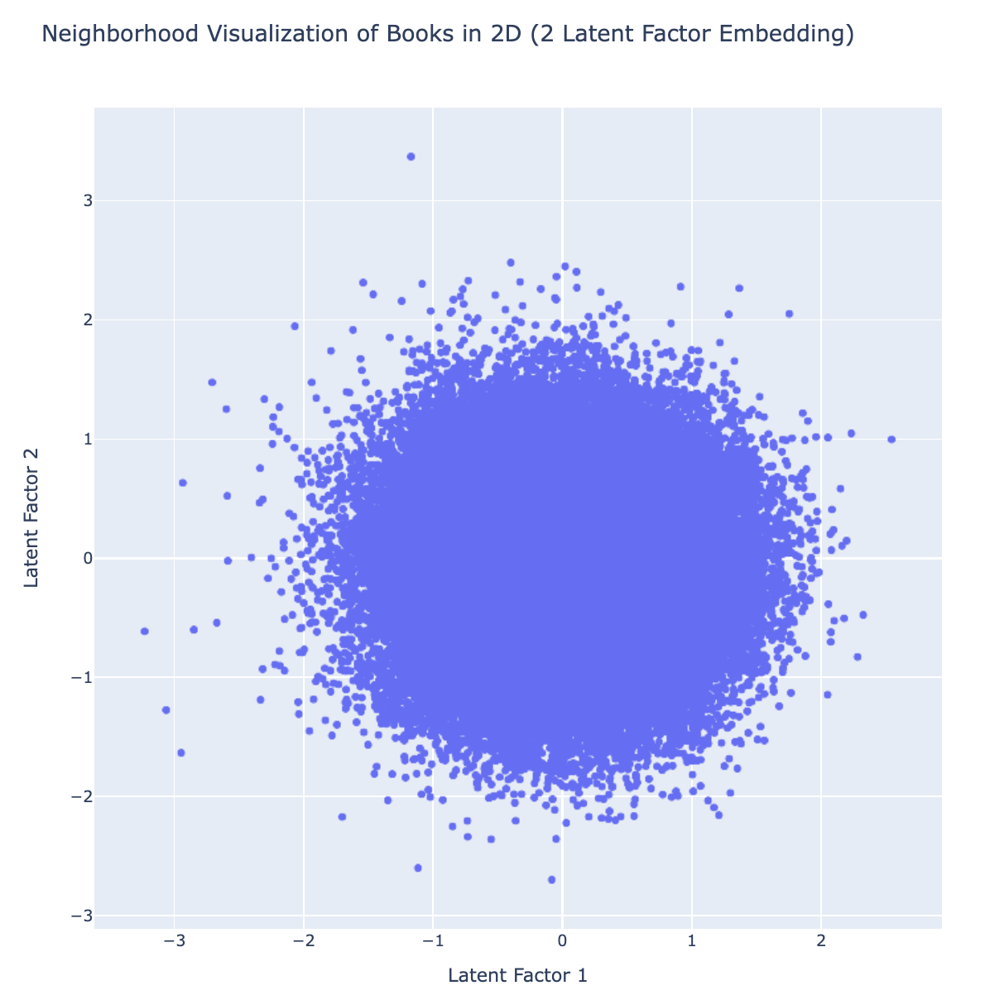

Above we can see the scatterplot, where the x axis and y axis correspond to latent factors 1 and 2, on a scale from -3 to +3 each.  Using this, we can visualize nearest neighbors of various books and gather some idea of what these latent factors indirectly measure.  

For instance, the bottom right corner seems to have a number of books that although non-fiction explore divinity or mystical elements, ex. "A Psychic's Tour of the Afterlife", "Kiss of God", etc.  Conversely, the top-left corner centers around historical fiction and non-fiction that is more grounded in reality, such as "Uncle Tom's Cabin" and "Birds of America".

## Item-Based Collaborative Filtering

Item-Based CF work differently than Singular Value Decomposition (Model Based variant).  Rather than relying on latent factors to populate a sparse matrix, it directly calculates item-item similarity through a similarity matrix (from the given data).  The algorithm can determine based on a user expressing interest and positive inclination towards item A, whether that is also linked to liking item B. After which, we can confidently recommend (or not show) the user item B.

In [51]:
# Clearly specify item-based collaborative filtering
sim_options = {'name': 'cosine', 'user_based': False}
algo_item_based = KNNBasic(k=20, sim_options=sim_options) # Consider the 5 nearest neighbors

# Standard 80 / 20 train test split
trainset_item, testset_item = train_test_split(data, test_size=.20, random_state=my_seed)

In [52]:
# Keep books with at least 10 ratings / enough info (to trim down the dataset for manageability in the KNN model, limit memory overuse)
popular_books = ratings_CF_df['ISBN'].value_counts()
popular_books = popular_books[popular_books >= 10].index
ratings_popular_df = ratings_CF_df[ratings_CF_df['ISBN'].isin(popular_books)]

data_popular = Dataset.load_from_df(ratings_popular_df[['User-ID', 'ISBN', 'Book-Rating']], reader)

trainset_item, testset_item = train_test_split(data_popular, test_size=.20, random_state=my_seed)

In [53]:
algo_item_based.fit(trainset_item); # Fit based on training data

predictions_item = algo_item_based.test(testset_item)

accuracy.rmse(predictions_item);
accuracy.mae(predictions_item);

Computing the cosine similarity matrix...
Done computing similarity matrix.
RMSE: 1.7619
MAE:  1.3099


In [54]:
# Format our dataset to Surprise's requirements
reader = Reader(rating_scale=(1, 10)) # 1-10 "star" ratings for each book
data_smaller = Dataset.load_from_df(ratings_popular_df[['User-ID', 'ISBN', 'Book-Rating']], reader)

In [55]:
performance_item = cross_validate(
    algo_item_based, data_smaller, measures=['RMSE', 'MAE'],
    cv=KFold(n_splits=5, random_state=my_seed),
    return_train_measures=True, verbose=True, n_jobs=-1
)

Evaluating RMSE, MAE of algorithm KNNBasic on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.7849  1.7749  1.7548  1.7547  1.7619  1.7663  0.0119  
MAE (testset)     1.3194  1.3214  1.3076  1.3011  1.3099  1.3119  0.0075  
RMSE (trainset)   1.2675  1.2655  1.2668  1.2646  1.2675  1.2664  0.0011  
MAE (trainset)    0.8588  0.8557  0.8562  0.8543  0.8571  0.8564  0.0015  
Fit time          5.31    5.05    8.54    6.44    2.19    5.50    2.06    
Test time         1.68    1.64    1.66    1.66    0.87    1.50    0.32    


In [56]:
print("Average Test RMSE:", np.mean(performance_item['test_rmse']))
print("Average Train RMSE:", np.mean(performance_item['train_rmse']))
print("--")
print("Average Test MAE:", np.mean(performance_item['test_mae']))
print("Average Train MAE:", np.mean(performance_item['train_mae']))

Average Test RMSE: 1.7662504814675177
Average Train RMSE: 1.266387821103902
--
Average Test MAE: 1.311887196757926
Average Train MAE: 0.8564151767812905


The average across all folds, along with the standard deviations above confirms the consistency of these results.

Let us now test the prediction effectiveness of our algorithm.

Note that both RMSE and MAE (the industry standard proxies of accuracy) have decreased by slightly more than 0.1 for the item based CF, as compared to a random distribution.  This collaborative filtering mechanism is thus also a success and great improvement.

In [57]:
predictions_item = algo_item_based.test(testset_item)
print(len(testset_item))
print(len(predictions_item))
print(len(testset_item) == len(predictions_item))

28622
28622
True


Verifying that the test set items is indeed what we are predicting off of

In [58]:
predictions_item[:10]

[Prediction(uid=229741, iid='0060958022', r_ui=7.0, est=7.551644359583939, details={'actual_k': 20, 'was_impossible': False}),
 Prediction(uid=212467, iid='1558748865', r_ui=10.0, est=5.0, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid=53220, iid='0060185074', r_ui=9.0, est=8.6, details={'actual_k': 20, 'was_impossible': False}),
 Prediction(uid=276038, iid='0684872153', r_ui=8.0, est=9.331344777384162, details={'actual_k': 3, 'was_impossible': False}),
 Prediction(uid=143814, iid='0393320979', r_ui=9.0, est=7.762210886730487, details={'was_impossible': True, 'reason': 'User and/or item is unknown.'}),
 Prediction(uid=209684, iid='0425092178', r_ui=8.0, est=8.795935672316482, details={'actual_k': 5, 'was_impossible': False}),
 Prediction(uid=159858, iid='0515118656', r_ui=7.0, est=9.0, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid=133296, iid='0671873199', r_ui=10.0, est=8.949226132578008, details={'actual_k': 20, 'was_impossible': False}),
 Pre

We can see that there are some close estimates such as 7.55 for 7.0 for user 229741, Book ISBN 0060958022.  We can also see estimates of 5.0 for true ratings of 10.0 (indicating that this algorithm still makes errors and is not impervious to faulty recommendations).

In [59]:
# We're looking at the same user as with the corresponding example in the Model-Based algorithm

uid = 1903
iid = '0316441791'

pred = algo_item_based.predict(uid, iid, r_ui=5, verbose=True) # Should have the same value as from the dataframe above

user: 1903       item: 0316441791 r_ui = 5.00   est = 7.76   {'was_impossible': True, 'reason': 'User and/or item is unknown.'}


In [60]:
num_ratings_by_user_df = ratings_CF_df.groupby('User-ID').size()
num_ratings_by_user_df[num_ratings_by_user_df >= 20].sort_values().head(10)

,0
User-ID,
278843,20
18850,20
154441,20
154354,20
37447,20
151824,20
150067,20
144516,20
144194,20


Again, we're looking at the same user as corresponding with the Model-Based recommendations ranking test.  This way we can see if the ranking order changes or performs better from one algorithm to the next (which would be revealed by differences in RMSE and MAE per se).

In [61]:
uid = 151824
given_user_df = ratings_CF_df[ratings_CF_df['User-ID'] == uid].sort_values(by='Book-Rating', ascending=False)
given_user_df.merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,Child of Venus,10
1,Obstruction of Justice,10
2,Alice's Tulips,10
3,Angel of Darkness (Key Books),10
4,"Three Complete Novels: Mind Prey, Sudden Prey,...",10
5,Year of Wonders: A Novel of the Plague,10
6,A Stitch in Time (Needlecraft Mysteries),10
7,The Red Tent (Bestselling Backlist),10
8,Stone Kiss (Peter Decker &amp; Rina Lazarus No...,10
9,Barrel Fever : Stories and Essays (Barrel Fever),9


In [62]:
already_rated = given_user_df['ISBN'].unique()
all_items = ratings_CF_df['ISBN'].unique()
items_to_rate = [x for x in all_items if x not in already_rated]

all_predictions_item = {}
for iid in tqdm(items_to_rate):
    est = algo_item_based.predict(uid, iid).est
    all_predictions_item[iid] = est

top_11_items = sorted(all_predictions_item.items(), reverse=True, key=lambda x: x[1])[:12]
pd.DataFrame(top_11_items, columns=['ISBN', 'Book-Rating']) \
  .merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

100%|██████████| 185953/185953 [00:00<00:00, 206083.28it/s]


,Book-Title,Book-Rating
0,A Painted House,10
1,Little Altars Everywhere,10
2,Waiting to Exhale,10
3,Birdsong: A Novel of Love and War,10
4,See Jane Run,10
5,False Memory,10
6,A Wrinkle In Time,10
7,"Artemis Fowl (Artemis Fowl, Book 1)",10
8,Back When We Were Grownups : A Novel (Ballanti...,10
9,Harry Potter und der Stein der Weisen,10


In [63]:
bottom_11_items = sorted(all_predictions_item.items(), reverse=False, key=lambda x: x[1])[:11]
pd.DataFrame(bottom_11_items, columns=['ISBN', 'Book-Rating']) \
  .merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,Pandora: New Tales of the Vampires (New Tales ...,5.0
1,Traveling Mercies: Some Thoughts on Faith,5.0
2,FORREST GUMP (Movie Tie in),5.0
3,The Big Sleep,5.0
4,Black Notice,5.0
5,Zodiac: The Eco-Thriller,5.0
6,"In the Garden of Iden (A Novel of the Company,...",5.0
7,The Book of Shadows,5.0
8,2001: A Space Odyssey,5.0


Note the rankings look quite similar for what would be liked by this user, however what is disliked is rather different as compared to the results of Model-Based recommending.  This user seems to like fiction and mystical fantasy and not like serious or thriller-realism styles of books.

In [64]:
pred_df_item = pd.DataFrame([(x.r_ui, x.est) for x in predictions_item],
                            columns=['true_rating', 'predicted_rating'])
pred_df_item.head(10)

,true_rating,predicted_rating
0,7.0,7.551644
1,10.0,5.000000
2,9.0,8.600000
3,8.0,9.331345
4,9.0,7.762211
5,8.0,8.795936
6,7.0,9.000000
7,10.0,8.949226
8,10.0,9.333119
9,10.0,7.762211


Based on comparing true ratings to what the model's output was for a particular book we can get a visual of where our RMSE comes from and how aligned these two values are distributionally

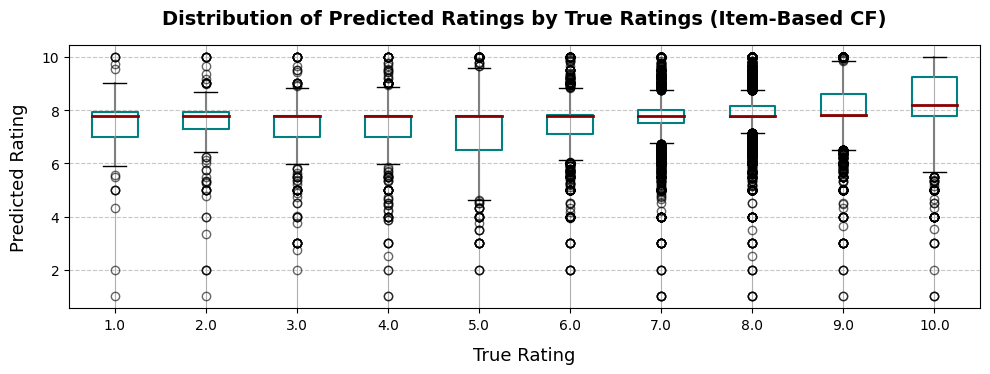

In [65]:
fig, ax = plt.subplots(figsize=(10, 4))

# Enhanced boxplot
bp = pred_df_item.boxplot(
    by="true_rating", ax=ax,
    boxprops=dict(linewidth=1.5, color='teal'),
    medianprops=dict(linewidth=2, color='darkred'),
    whiskerprops=dict(color='gray', linewidth=1.5),
    flierprops=dict(marker='o', color='purple', alpha=0.6)
)

# Aesthetic adjustments explicitly
bp.get_figure().suptitle('')
ax.set_title('Distribution of Predicted Ratings by True Ratings (Item-Based CF)', fontsize=14, fontweight='bold', pad=15)
ax.set_xlabel('True Rating', fontsize=13, labelpad=10)
ax.set_ylabel('Predicted Rating', fontsize=13, labelpad=10)
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

The box plot has some upwards trend although, again, it struggles with low ratings often over-estimating book rathings below 8, as the mean seems to center around 8.0 with very little increase as the true value trends towards 10.0.  There are also a high quantity of outliers between 6.0 and 8.0 indicating that the algorithm had high variance when ranking something within that "decent to good" range.

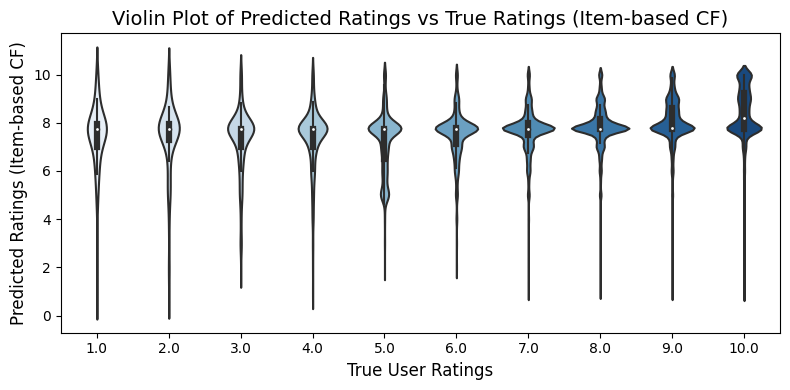

In [66]:
fig, ax = plt.subplots(figsize=(8, 4))
sns.violinplot(
    data=pred_df_item,
    x="true_rating",
    y="predicted_rating",
    palette="Blues"
)

ax.set_xlabel("True User Ratings", fontsize=12)
ax.set_ylabel("Predicted Ratings (Item-based CF)", fontsize=12)
ax.set_title("Violin Plot of Predicted Ratings vs True Ratings (Item-based CF)", fontsize=14)

plt.tight_layout()
plt.show()

An alternate representation of the same data is with a violin plot which reveals the extent of the outliers and the shape of the 1st to 3rd quartile region.  We see that the distribution narrows towards higher values as the true ratings approach 10, however the mean stays between 7.8 and 8.2 approximately.

## User-Based Collaborative Filtering w/ Hyperparameter Analysis

User-Based CF work near identically to Item-Based CF, though the data subject is different.  Rather than relying on item similarity matirces, it operates on user-user similarity through a similarity matrix (from the given data).  The algorithm can determine based on user A expressing interest and positive inclination towards an item A, whether that is also linked to user B liking that same item. After which, we can determine which users have similar tastes, and accordingly recommend them similar items (books) that one has read but another hasn't.

In [67]:
# Clearly specify user-based collaborative filtering
sim_options = {'name': 'cosine', 'user_based': True}
algo_user_based = KNNBasic(k=5, sim_options=sim_options)  # Initial k=5

# Standard 80 / 20 train test split
trainset_user, testset_user = train_test_split(data, test_size=.20, random_state=my_seed)

In [68]:
# Keep only users with enough ratings (trim dataset for efficiency)
popular_users = ratings_CF_df['User-ID'].value_counts()
popular_users = popular_users[popular_users >= 10].index  # Users who rated at least 10 books
ratings_popular_users_df = ratings_CF_df[ratings_CF_df['User-ID'].isin(popular_users)]


In [69]:
data_popular_users = Dataset.load_from_df(ratings_popular_users_df[['User-ID', 'ISBN', 'Book-Rating']], reader)

trainset_user, testset_user = train_test_split(data_popular_users, test_size=.20, random_state=my_seed)

# Fit the user-based CF model
algo_user_based.fit(trainset_user)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [70]:
# Make predictions
predictions_user = algo_user_based.test(testset_user)

In [71]:
# Evaluate accuracy
accuracy.rmse(predictions_user);
accuracy.mae(predictions_user);

RMSE: 1.9646
MAE:  1.5525


In [72]:
# Cross-validation on the user-based CF model
performance_user = cross_validate(
    algo_user_based, data_popular_users, measures=['RMSE', 'MAE'],
    cv=KFold(n_splits=5, random_state=my_seed),
    return_train_measures=True, verbose=True, n_jobs=-1
)

Evaluating RMSE, MAE of algorithm KNNBasic on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    1.9608  1.9633  1.9597  1.9579  1.9646  1.9613  0.0024  
MAE (testset)     1.5505  1.5543  1.5496  1.5483  1.5525  1.5511  0.0021  
RMSE (trainset)   1.1909  1.1882  1.1900  1.1898  1.1880  1.1894  0.0011  
MAE (trainset)    0.7201  0.7193  0.7192  0.7199  0.7188  0.7194  0.0005  
Fit time          9.71    9.21    5.04    4.51    2.91    6.28    2.70    
Test time         1.37    1.33    1.39    1.45    0.80    1.27    0.24    


The average across all folds, along with the standard deviations above confirms the consistency of these results.


Let us now test the prediction effectiveness of our algorithm.

In [73]:
print("Average Test RMSE (User-Based CF):", np.mean(performance_user['test_rmse']))
print("Average Train RMSE (User-Based CF):", np.mean(performance_user['train_rmse']))
print("--")
print("Average Test MAE (User-Based CF):", np.mean(performance_user['test_mae']))
print("Average Train MAE (User-Based CF):", np.mean(performance_user['train_mae']))

Average Test RMSE (User-Based CF): 1.961256805687443
Average Train RMSE (User-Based CF): 1.1894091158335454
--
Average Test MAE (User-Based CF): 1.551060953924005
Average Train MAE (User-Based CF): 0.7194479479204027


Note that both RMSE and MAE (the industry norms that measure accuracy) have decreased by less than 0.1 for the item based CF, as compared to a random distribution in the initial data exploration.  This collaborative filtering mechanism is thus also effective and shows some level of effectiveness, though of all the CF's so far it seems the least precise.

In [74]:
# Check if predictions length matches testset
print(len(testset_user))
print(len(predictions_user))
print(len(testset_user) == len(predictions_user))  # Should be True

# View first 10 predictions
predictions_user[:10]

59113
59113
True


[Prediction(uid=42573, iid='0061092622', r_ui=7.0, est=7.690862261469753, details={'was_impossible': True, 'reason': 'Not enough neighbors.'}),
 Prediction(uid=189835, iid='0394406672', r_ui=5.0, est=7.690862261469753, details={'was_impossible': True, 'reason': 'User and/or item is unknown.'}),
 Prediction(uid=229409, iid='0553574639', r_ui=7.0, est=10, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid=276231, iid='0671003755', r_ui=2.0, est=7.8, details={'actual_k': 5, 'was_impossible': False}),
 Prediction(uid=170077, iid='0140171673', r_ui=6.0, est=8.0, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid=203017, iid='0060968966', r_ui=9.0, est=8.0, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid=2766, iid='0385508417', r_ui=7.0, est=7.7929998480875255, details={'actual_k': 5, 'was_impossible': False}),
 Prediction(uid=156111, iid='1569319944', r_ui=10.0, est=7.690862261469753, details={'was_impossible': True, 'reason': 'User and/or 

Yet again there is inconsistencies, in the form of true ratings of 2.0 being estimated as 7.8, 9.0's being 6.78 but these seem fewer and far between, and the deviation by which the estimates fall from the mark is also less than the random distribution, meaning that this algorithm is an improvement, as the accuracy metrics suggested.

In [75]:
# Select a user for generating recommendations
uid = 151824  # Example user
given_user_df = ratings_CF_df[ratings_CF_df['User-ID'] == uid].sort_values(by='Book-Rating', ascending=False)

# Merge with books data for readability
given_user_df.merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,Child of Venus,10
1,Obstruction of Justice,10
2,Alice's Tulips,10
3,Angel of Darkness (Key Books),10
4,"Three Complete Novels: Mind Prey, Sudden Prey,...",10
5,Year of Wonders: A Novel of the Plague,10
6,A Stitch in Time (Needlecraft Mysteries),10
7,The Red Tent (Bestselling Backlist),10
8,Stone Kiss (Peter Decker &amp; Rina Lazarus No...,10
9,Barrel Fever : Stories and Essays (Barrel Fever),9


In [76]:
# Generate predictions for unseen books
already_rated = given_user_df['ISBN'].unique()
all_items = ratings_CF_df['ISBN'].unique()
items_to_rate = [x for x in all_items if x not in already_rated]

all_predictions_user = {}
for iid in tqdm(items_to_rate):
    est = algo_user_based.predict(uid, iid).est
    all_predictions_user[iid] = est

100%|██████████| 185953/185953 [00:01<00:00, 147380.18it/s]


Yet again, we're looking at the same user as corresponding with the Item-Based recommendations ranking test.  This way we can see if the ranking order changes or performs better from one algorithm to the next (which would be revealed by differences in RMSE and MAE per se).

In [77]:
# Top 11 recommended books
top_11_user_items = sorted(all_predictions_user.items(), reverse=True, key=lambda x: x[1])[:12]
pd.DataFrame(top_11_user_items, columns=['ISBN', 'Book-Rating']).merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]

,Book-Title,Book-Rating
0,Birdsong: A Novel of Love and War,10
1,The Pillars of the Earth,10
2,False Memory,10
3,The Boy Next Door,10
4,Attack Of The Deranged Mutant Killer Snow Goons,10
5,Calvin and Hobbes,10
6,Charlotte's Web,10
7,"Stronghold (Dragon Star, Book 1)",10
8,"The Dragon Token (Dragon Star, Book 2)",10
9,Dragons of Winter Night,10


In [78]:
# Bottom 11 least recommended books
bottom_11_user_items = sorted(all_predictions_user.items(), reverse=False, key=lambda x: x[1])[:11]
pd.DataFrame(bottom_11_user_items, columns=['ISBN', 'Book-Rating']).merge(books_df, on='ISBN')[['Book-Title', 'Book-Rating']]


,Book-Title,Book-Rating
0,Adressat unbekannt.,1
1,Et Si C'Etait Vrai / If This Were Only True,1
2,I Choose You (Pokemon Chapter Book #1),1
3,Absolute Power,1
4,The Green Mile: The Complete Serial Novel,1
5,Small Miracles: Extraordinary Coincidences fro...,1
6,Mint Julep Murder,1
7,The Regulators,1


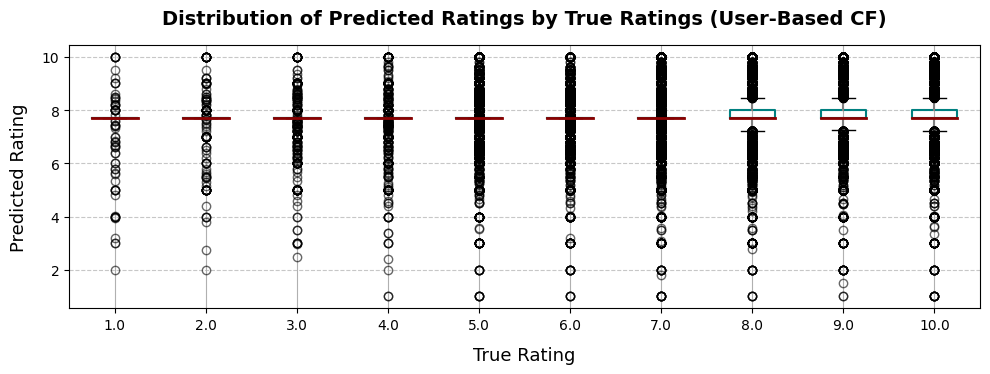

In [79]:
# Prepare dataframe for visualization
pred_df_user = pd.DataFrame([(x.r_ui, x.est) for x in predictions_user],
                            columns=['true_rating', 'predicted_rating'])

# Boxplot
fig, ax = plt.subplots(figsize=(10, 4))
bp = pred_df_user.boxplot(
    by="true_rating", ax=ax,
    boxprops=dict(linewidth=1.5, color='teal'),
    medianprops=dict(linewidth=2, color='darkred'),
    whiskerprops=dict(color='gray', linewidth=1.5),
    flierprops=dict(marker='o', color='purple', alpha=0.6)
)

bp.get_figure().suptitle('')
ax.set_title('Distribution of Predicted Ratings by True Ratings (User-Based CF)', fontsize=14, fontweight='bold', pad=15)
ax.set_xlabel('True Rating', fontsize=13, labelpad=10)
ax.set_ylabel('Predicted Rating', fontsize=13, labelpad=10)
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


This distribution has a very small 1st to 3rd quartile region for all its discrete true values, this means a large amount of data resides in a small area (75% of it) although for all values 1.0 to 10.0, the mean appears fixed at 7.8 to 7.9 never surpassing 8, regardless of the true rating.  Moroever the distributions widen as the true rating increases, meaning the algorithm is more uncertain when awarding higher estimated values.

Clearly it is consistent but unable to be certain with 10.0's and seldom gives out 1.0's even when the true ratings of books should be poor.

This algorithm's struggle to reach consistency in its predictions is further supported by the amount of outliers in the dataset.

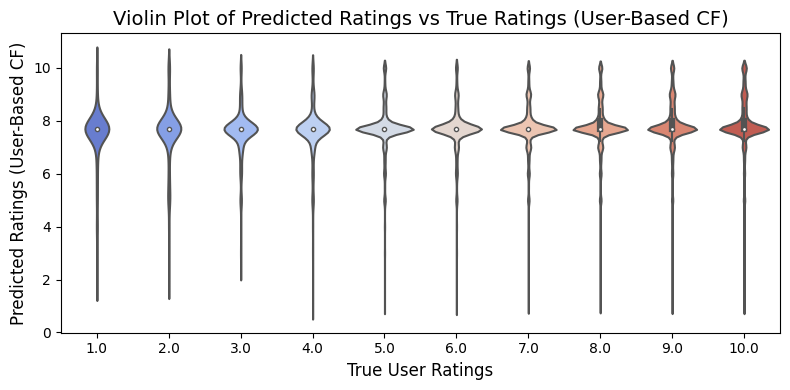

In [80]:
# Violin Plot
fig, ax = plt.subplots(figsize=(8, 4))
sns.violinplot(
    data=pred_df_user,
    x="true_rating",
    y="predicted_rating",
    palette="coolwarm"
)

ax.set_xlabel("True User Ratings", fontsize=12)
ax.set_ylabel("Predicted Ratings (User-Based CF)", fontsize=12)
ax.set_title("Violin Plot of Predicted Ratings vs True Ratings (User-Based CF)", fontsize=14)

plt.tight_layout()
plt.show()

Again, the violin plot reveals the same thing clearly showing the narrow bell shaped distribution across all true ratings, but with a mean that doesn't share the positive trend that its predictions should have alongside true user ratings.

In [81]:
# Vary K and evaluate RMSE with tqdm for progress tracking
k_values = [3, 20, 100]
rmse_results_user = {}

for k in tqdm(k_values, desc="Evaluating KNN (User-Based) with different K values"):
    sim_options = {'name': 'cosine', 'user_based': True}
    algo_knn = KNNBasic(k=k, sim_options=sim_options)

    # cross validate to ensure consistency amongst results
    performance = cross_validate(algo_knn, data_popular_users, measures=['RMSE'],
                                 cv=KFold(n_splits=5, random_state=my_seed),
                                 verbose=False, n_jobs=-1)

    rmse_results_user[k] = np.mean(performance['test_rmse'])

Evaluating KNN (User-Based) with different K values: 100%|██████████| 3/3 [01:19<00:00, 26.52s/it]


Note that the algorithm primarily ran in this module used K=5 for K nearest neighbors to develop an association between similar users to draw recommendations from.  

Hence, this is a hyperparameter that ought to be tuned or at least analyzed to determine how more or fewer neighbors impact the accuracy of predictions... We proxy this by testing the RMSE's of 3 discrete extremes: 3 (very few neighbors), 20 (a sizeable amount), 100 (likely too many; a value prone to overfitting).

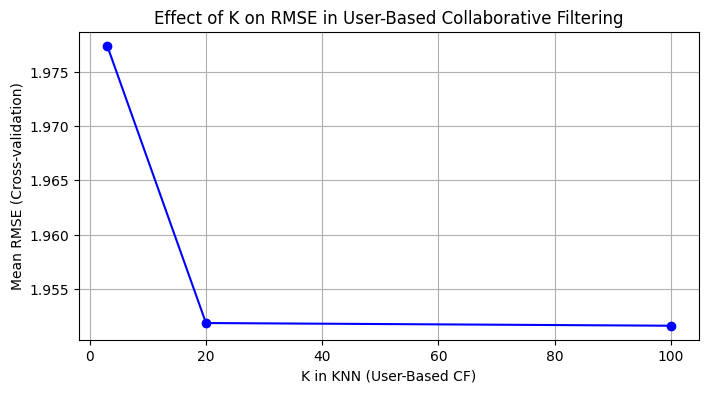

In [82]:
# Plot RMSE trends across K values, label the graph accordingly
plt.figure(figsize=(8, 4))
plt.plot(rmse_results_user.keys(), rmse_results_user.values(), marker='o', linestyle='-', color='blue')
plt.xlabel("K in KNN (User-Based CF)")
plt.ylabel("Mean RMSE (Cross-validation)")
plt.title("Effect of K on RMSE in User-Based Collaborative Filtering")
plt.grid(True)
plt.show()

indeed the difference / decrease in RMSE is significant, over 0.02 degrees are shed by increasing from 3 to 20 neighbors, however there is negligible error improvement of setting K to 100 (as we suspected), not matching the exortbitant extra computation demanded for such a model.

## Non-Personalized Recommenders

In [83]:
from surprise import AlgoBase

# Identical to a normally distributed random algorithm as seen during lectures
# Set to the population mean and standard deviation of our training data (of book ratings 1-10)
class RandomBookAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Generates a prediction using normal distribution centered on train data mean
        return np.random.normal(loc=self.train_mean, scale=self.train_std)

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        # Extract all ratings from the training set
        ratings = [r for (_, _, r) in trainset.all_ratings()]

        # Compute dataset-wide mean & standard deviation
        self.train_mean = np.mean(ratings)
        self.train_std = np.std(ratings)

        return self

# Instantiate and Train Random Recommender
random_RS = RandomBookAlgorithm()

In [84]:
# Train/Test Split for Random Model as good practice dictates
trainset_random, testset_random = train_test_split(data, test_size=0.20, random_state=my_seed)

random_RS.fit(trainset_random)
predictions_random = random_RS.test(testset_random)

In [85]:
# Evaluate Performance
accuracy.rmse(predictions_random)
accuracy.mae(predictions_random)

RMSE: 2.5018
MAE:  1.9983


1.99834114533976

Note the extremely high RMSE and MAE that are expected from a random prediction algorithm.  This is the result of pure, uninformed guesswork and should be a control for the worst possible recommender.

In [86]:
# Custom Popular Book Recommender System

# Also as seen in lecture
class PopularBookAlgorithm(AlgoBase):

    def __init__(self):
        AlgoBase.__init__(self)

    def estimate(self, u, i):
        # Uses the item's average rating if available, otherwise defaults to the global mean
        if i in self.mean_rating_per_item_df.index:
            return self.mean_rating_per_item_df.loc[i]['rating']
        else:
            return self.trainset.global_mean

    def fit(self, trainset):
        AlgoBase.fit(self, trainset)

        # Convert training set into a DataFrame for easier aggregation
        ratings_df = pd.DataFrame([[i, r] for (_, i, r) in trainset.all_ratings()],
                                  columns=['item', 'rating'])

        # Compute the mean rating for each book
        self.mean_rating_per_item_df = ratings_df.groupby('item').agg({'rating': 'mean'})

        return self

# Instantiate and train the Popular Book Recommender
popular_RS = PopularBookAlgorithm()

In [87]:
# Train/Test Split
trainset_popular, testset_popular = train_test_split(data, test_size=0.20, random_state=my_seed)

popular_RS.fit(trainset_popular)
predictions_popular = popular_RS.test(testset_popular)

In [88]:
accuracy.rmse(predictions_popular)
accuracy.mae(predictions_popular)

RMSE: 1.9421
MAE:  1.5297


1.529700646436231

A popular recommender--(technically this is a predicter still) is expected to have improvement to its error values (which it does, by about 0.6 to both RMSE and MAE as compared to the random prediction algorithm).  

It bets on safe well-liked (ideally by many users) content, over a certain threshold and clearly this yields more consistent results.

However, we must now compared this performance against the three CF recommenders developed earlier.

## Evaluation Metrics



###RMSE Comparison

In [89]:
# ---------------------------
# Compile RMSE and MAE Results
# ---------------------------
evaluation_results = {
    "Recommender": [
        "Random RS",
        "Popular RS",
        "Model-Based CF (SVD)",
        "Item-Based CF (KNN)",
        "User-Based CF (KNN)"
    ],
    "RMSE Results": [
        accuracy.rmse(predictions_random),
        accuracy.rmse(predictions_popular),
        np.mean(performance_mb['test_rmse']),
        np.mean(performance_item['test_rmse']),
        np.mean(performance_user['test_rmse'])
    ],
    "MAE Results": [
        accuracy.mae(predictions_random),
        accuracy.mae(predictions_popular),
        np.mean(performance_mb['test_mae']),
        np.mean(performance_item['test_mae']),
        np.mean(performance_user['test_mae'])
    ],
}

# Convert dictionary to DataFrame for clean display
evaluation_df = pd.DataFrame(evaluation_results)

evaluation_df.head(10)

RMSE: 2.5018
RMSE: 1.9421
MAE:  1.9983
MAE:  1.5297


,Recommender,RMSE Results,MAE Results
0,Random RS,2.501794,1.998341
1,Popular RS,1.942086,1.529701
2,Model-Based CF (SVD),1.641200,1.266845
3,Item-Based CF (KNN),1.766250,1.311887
4,User-Based CF (KNN),1.961257,1.551061


Purely numerically, it becomes clear that the best recommender is the Model-Based as it has both the lowest Root Mean Squared Error and Mean Absolute Error, so is the most accurate, precise, and consistent across these two fronts.

Conversely, random as expected peformed the worst by a high margin with large error and large inconsistency.

Item-Based came closely behind Model-Based as quite an effective CF recommender system, only about 0.1 or less away from the results that SVD boasts (for both RMSE and MAE).

Interestingly, the popular recommender outperformed the user based collobrative filtering KNN algorithm by a slight margin for both RMSE and MAE.  This may be because K=5 yielded poor performance--not enough neighbor information to make nuanced rankings (as the hyperparameter analysis and rudimentary tuning revealed in the following module.  

Nonetheless, MAE is a measure designed to punish outliers that RMSE's function doesn't weigh as heavily due to their sparsity, which is why Popularity manages to have low MAE (there are very few outlier users that have a distaste for the majorly popular items).

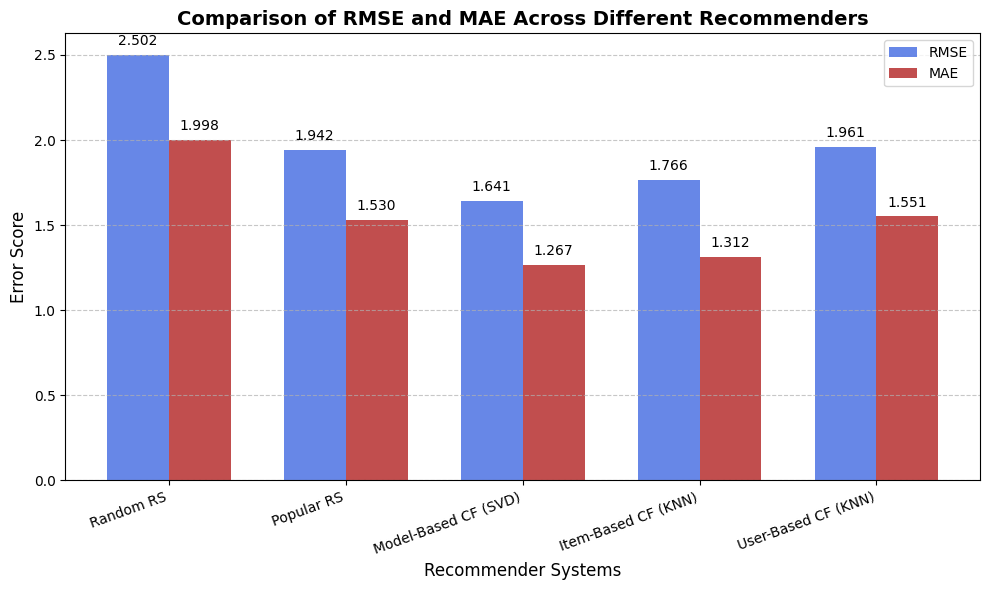

In [90]:
# Plot bar chart for RMSE and MAE
fig, ax = plt.subplots(figsize=(10, 6))
x = np.arange(len(evaluation_df["Recommender"]))

width = 0.35  # Bar width
rects1 = ax.bar(x - width/2, evaluation_df["RMSE Results"], width, label="RMSE", color='royalblue', alpha=0.8)
rects2 = ax.bar(x + width/2, evaluation_df["MAE Results"], width, label="MAE", color='firebrick', alpha=0.8)

# Labels and formatting
ax.set_xlabel("Recommender Systems", fontsize=12)
ax.set_ylabel("Error Score", fontsize=12)
ax.set_title("Comparison of RMSE and MAE Across Different Recommenders", fontsize=14, fontweight="bold")
ax.set_xticks(x)
ax.set_xticklabels(evaluation_df["Recommender"], rotation=20, ha="right", fontsize=10)
ax.legend()

# Annotate bars with values
for rect in rects1 + rects2:
    height = rect.get_height()
    ax.annotate(f"{height:.3f}",  # Format to 3 decimal places
                xy=(rect.get_x() + rect.get_width() / 2, height),
                xytext=(0, 5),  # Offset text slightly above bars
                textcoords="offset points",
                ha="center", va="bottom", fontsize=10)

ax.grid(axis='y', linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

###Coverage Analysis

In [91]:
import gc

# Helper function as seen in lecture
def get_top_n(predictions, n=10, solve_ties=False):
    from collections import defaultdict
    """Return the top-N recommendation for each user from a set of predictions.

    Args:
        predictions(list of Prediction objects): The list of predictions, as
            returned by the test method of an algorithm.
        n(int): The number of recommendation to output for each user. Default
            is 10.
        solve_ties(bool): Solve prediction ties by using the item id.

    Returns:
    A dict where keys are user (raw) ids and values are lists of tuples:
        [(raw item id, rating estimation), ...] of size n.
    """

    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        if solve_ties:
            user_ratings.sort(key=lambda x: (x[1], x[0]), reverse=True)
        else:
            user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [92]:
subset_users = pd.DataFrame(ratings_df['User-ID'].unique(), columns=['User-ID']).sample(frac=.001, random_state=my_seed)
ratings_filt_df = ratings_df.merge(subset_users, on='User-ID')
# Note this evaluation is derived from a small fraction of the full ratings dataframe for computational efficiency
# It demonstrates the same effect that observing and running on all user data would

# Important Improvement from class: higher max rating to avoid rec scores being capped at score=10 and not distinguishing top items a little more intensely
# Else, random recommender will not perform as strongly due to the capping also reducing perceived coverage
reader = Reader(rating_scale=(1, 20))
data_filt = Dataset.load_from_df(ratings_filt_df[['User-ID', 'ISBN', 'Book-Rating']], reader)

In [93]:
print(f"There are {ratings_df['User-ID'].nunique()} unique users")
print(f"There are {ratings_df['ISBN'].nunique()} unique books")
print(f"There are {ratings_df.shape[0]} ratings")
# Before filtering

There are 105283 unique users
There are 340556 unique books
There are 1149780 ratings


In [94]:
print(f"There are {ratings_filt_df['User-ID'].nunique()} unique users")
print(f"There are {ratings_filt_df['ISBN'].nunique()} unique books")
print(f"There are {ratings_filt_df.shape[0]} ratings")
# After applying the fix to ensure we measure all algorithm's coverage, uncapped

There are 105 unique users
There are 1398 unique books
There are 1435 ratings


In [95]:
# Solution to the bad practice / mistake seen in lecture

trainset_coverage = data_filt.build_full_trainset()
testset_coverage = trainset_coverage.build_anti_testset()

In [96]:
ratings_filt_df['User-ID'].nunique() * ratings_filt_df['ISBN'].nunique() - ratings_filt_df.shape[0]

145355

In [97]:
catalog = [trainset_coverage.to_raw_iid(inner_iid) for inner_iid in trainset_coverage.all_items()]

Note that here we move on with our best contender Collobrative Filtering algorthm: SVD Model-Based to compare these discrete styles of recommenders and their performance in the coverage metric.

In [98]:
random_RS.fit(trainset_coverage);
popular_RS.fit(trainset_coverage);
algo_model_based.fit(trainset_coverage);

# Training the algorithms to calculate coverage based on the exact same dataset

The following identical sections of code run the testing for the recommender / prediction models, and pick a top set of items from a catalog for which to calculate coverage using the recmetrics library function.

In [99]:
predictions_random = random_RS.test(testset_coverage)
top_n_random = get_top_n(predictions_random, n=50)
top_n_random_only_items = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_random.values()]
coverage_random = recmetrics.prediction_coverage(top_n_random_only_items, catalog)
print(coverage_random)

del predictions_random, top_n_random, top_n_random_only_items
gc.collect(); # clean memory and garbage since this is a time and memory consuming process

96.85


In [100]:
predictions_popular = popular_RS.test(testset_coverage)
top_n_popular = get_top_n(predictions_popular, n=50, solve_ties=True)  # Remove randomness
top_n_popular_only_items = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_popular.values()]
coverage_popular = recmetrics.prediction_coverage(top_n_popular_only_items, catalog)
print(coverage_popular)

del predictions_popular, top_n_popular, top_n_popular_only_items
gc.collect();

5.87


In [101]:
predictions_cf = algo_model_based.test(testset_coverage)
top_n_cf = get_top_n(predictions_cf, n=50)
top_n_cf_only_items = [[iid for (iid, _) in user_ratings] for user_ratings in top_n_cf.values()]
coverage_cf = recmetrics.prediction_coverage(top_n_cf_only_items, catalog)
print(coverage_cf)

del predictions_cf, top_n_cf, top_n_cf_only_items
gc.collect();

35.05


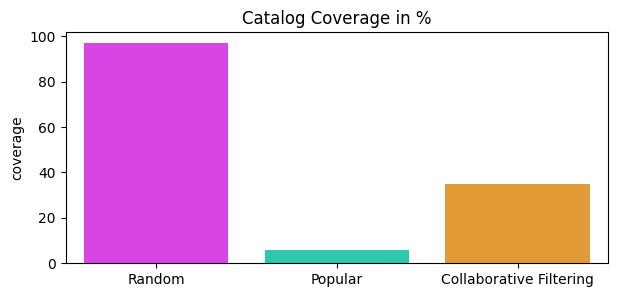

In [102]:
fig = plt.figure(figsize=(7, 3))
model_names = ['Random', 'Popular', 'Collaborative Filtering']
recmetrics.coverage_plot([coverage_random, coverage_popular, coverage_cf], model_names)

Just as seen in class, the results are as expected, random has almost full coverage from the catalog of books, meaning that every book in the item "database" appears as a recommendation to some user (in practice).

Moreover, the popular recommender only shows a select few very popular items (well rated books) so it exhibits the head property of the long-tail phenomenon and covers very few books from the full dataset, roughly 6%

The ability of SVD to understand user's niche through latent factors ensures it can be a bit more confident with overall less popular or even less-liked books that it has inferred from the prediction matrix a particular user would "appreciate".  This allows the Model-Based CF recommender to achieve coverage of over 1/3 of the full books set.

Hence the visuals here are in line with expectations and this experiment further confirms the success of the model-based recommender.

###NDCG Performance

In [103]:
from sklearn.metrics import ndcg_score # Net Discounted Cumulative Gain, a metric that
# directly correlates to how well ordered a recommendation prediction list is with the
# ground truth ranking that a user would create

In [104]:
final_trainset, final_testset = train_test_split(data, test_size=0.20, random_state=my_seed) # standard split
# consistent dataset across all engine models for this evaluation metric

In [105]:
# Generate predictions and properly structure them into DataFrames
def generate_predictions_dataframe(recommender, testset):
    predictions = recommender.test(testset)  # List of Prediction objects
    return pd.DataFrame([(pred.uid, pred.iid, pred.r_ui, pred.est) for pred in predictions],
                        columns=['uid', 'iid', 'r_ui', 'est'])

# Compute NDCG for multiple users
# Want to ensure reduction of bias / getting lucky with a particular user's order
# Need to consider many users for an average NDCG
def ndcg_multiple_users(relevant_items_all_users, predictions_ranking_all_users, k=50):
    ndcg_list = []
    for i in range(len(relevant_items_all_users)):
        if len(relevant_items_all_users[i]) > 20:  # Only consider users with more than 10 ratings
            ndcg = ndcg_score([relevant_items_all_users[i]],
                              [predictions_ranking_all_users[i]], k=k) # Library function
            ndcg_list.append(ndcg)
    return np.mean(ndcg_list) if ndcg_list else 0

# Compute NDCG for each model, accounting for all satisfactory users and their respective predictions / rankings
def compute_ndcg(predictions_df, k=50):
    by_user_df = predictions_df.groupby('uid')[['r_ui', 'est']].agg(lambda x: list(x))
    return ndcg_multiple_users(by_user_df['r_ui'].tolist(), by_user_df['est'].tolist(), k=k)

Note the most critical line from the code segment above is the one containing `len(relevant_items_all_users[i]) > 10`.  This is because without it we risk including many users from the long tail with 1 and 2 ratings.  The problem with this is that with 1 rating, the NDCG is trivially as high as possible (artificially inflating the mean).  

Even with 2 items, getting them mixed up doesn't discount the cumulative gain enough for the NDCG score to be harmed.

We want to distinguish and extend discrepancies to clearly see which recommender has the best rankings (with which we can proxy accuracy and precision).

In [106]:
# Recommenders are instantiated and trained
random_RS.fit(final_trainset)
popular_RS.fit(final_trainset)
algo_model_based.fit(final_trainset)

# Generate predictions for all three recommenders
predictions_random_df = generate_predictions_dataframe(random_RS, final_testset)
predictions_popular_df = generate_predictions_dataframe(popular_RS, final_testset)
predictions_cf_df = generate_predictions_dataframe(algo_model_based, final_testset)

In [107]:
# Compute NDCG@20 scores
ndcg_random = compute_ndcg(predictions_random_df, k=20)
ndcg_popular = compute_ndcg(predictions_popular_df, k=20)
ndcg_cf = compute_ndcg(predictions_cf_df, k=20)

# Store results in a dataframe for visualization
ndcg_results_df = pd.DataFrame({
    "Recommender": ["Random RS", "Popular RS", "Model-Based CF (SVD)"],
    "NDCG@20": [ndcg_random, ndcg_popular, ndcg_cf]
})

ndcg_results_df.head(10) # to ensure it shows all rows, even though there's only 3 recommenders / rows

,Recommender,NDCG@20
0,Random RS,0.879953
1,Popular RS,0.899838
2,Model-Based CF (SVD),0.900200


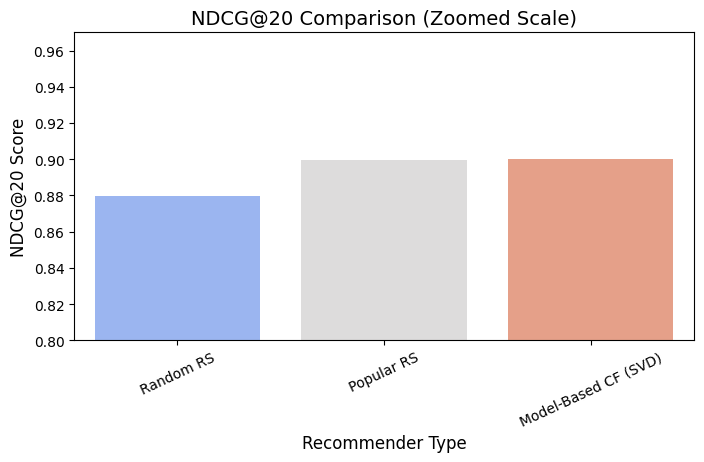

In [111]:
# Adjusted plot to zoom into the small differences in NDCG scores
plt.figure(figsize=(8, 4))
sns.barplot(x="Recommender", y="NDCG@20", data=ndcg_results_df, palette="coolwarm")

# Adjust y-axis scale for better differentiation
plt.ylim(0.8, 0.97)

plt.xlabel("Recommender Type", fontsize=12)
plt.ylabel("NDCG@20 Score", fontsize=12)
plt.title("NDCG@20 Comparison (Zoomed Scale)", fontsize=14)
plt.xticks(rotation=25)
plt.show()

Note that although the differences are minor between the different classes of recommender systems, there is still a definite trend.  Namely, the Random RS indeed has the lowest NDCG meaning its ability to predict the correct order of user rankings is the worst, and thus its rankings are the least close to the ground truth.

Comparatively, the Popular RS's ranking is an improvement upon Random's since its NDCG score is noticeably a few degrees higher and relatively close to the Model-Based algorithm's performance.

Nonetheless, the winner on NDCG as a proxy to accuracy is still Model-Based CF, evidently due to its ability to truly understand users, not just metadata or guesses about the population, what is generally well-liked, and what the population parameters of the books ranking dataset are.

The aforementioned properties describe the Random and Popular RS's, which lack the insight that SVD was able to provide, reflecting in it having the highest NDCG score and thus, the closest predicted ranking of users' preferences to their true rankings.